# MANUAL NET ARCHITECTURE

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import os
import glob
import numpy as np

from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.models import Sequential
from PIL import Image

from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Activation

from keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt

In [3]:
dyed_lifted_polyps = 'DATASET/TRAIN/dyed_lifted_polyps'
esophagus = 'DATASET/TRAIN/esophagus'
polyps = 'DATASET/TRAIN/polyps'

In [4]:
def plot_images(item_dir, n=6):
    all_item_dir = os.listdir(item_dir)
    item_files = [os.path.join(item_dir, file) for file in all_item_dir][:n]
    
    plt.figure(figsize=(80, 40))
    for idx, img_path in enumerate(item_files):
        plt.subplot(3, n, idx+1)
        img = plt.imread(img_path)
        plt.imshow(img, cmap='gray')
        plt.axis('off')
    
    plt.tight_layout()
    
def image_details_print(data,path):
    print('======== Images in: ', path)
    for key,values in data.items():
        print(key,':\t', values)


def images_details(path):
    files=[f for f in glob.glob(path + "**/*.*", recursive=True)]
    data={}
    data['Images_count']=len(files)
    data['Min_width']=10**100
    data['Max_width']=0
    data['Min_height']=10**100
    data['Max_height']=0
    
    for f in files:
        img=Image.open(f)
        width,height=img.size
        data['Min_width']=min(width,data['Min_width'])
        data['Max_width']=max(width, data['Max_width'])
        data['Min_height']=min(height, data['Min_height'])
        data['Max_height']=max(height, data['Max_height'])
        
    image_details_print(data,path)


TRAINING DATA FOR dyed_lifted_polyps:

======== Images in:  DATASET/TRAIN/dyed_lifted_polyps
Images_count :	 301
Min_width :	 720
Max_width :	 720
Min_height :	 576
Max_height :	 576



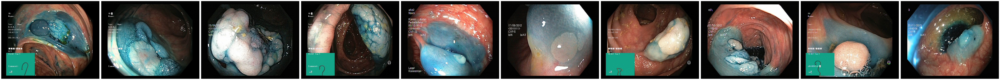

In [5]:
print("")
print("TRAINING DATA FOR dyed_lifted_polyps:")
print("")
images_details(dyed_lifted_polyps)
print("")
plot_images(dyed_lifted_polyps, 10) 


TRAINING DATA FOR esophagus:

======== Images in:  DATASET/TRAIN/esophagus
Images_count :	 301
Min_width :	 613
Max_width :	 1920
Min_height :	 512
Max_height :	 1072



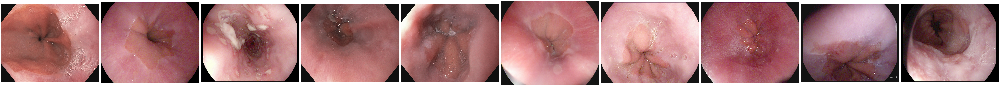

In [6]:
print("")
print("TRAINING DATA FOR esophagus:")
print("")
images_details(esophagus)
print("")
plot_images(esophagus, 10)


TRAINING DATA FOR polyps:

======== Images in:  DATASET/TRAIN/polyps
Images_count :	 301
Min_width :	 720
Max_width :	 1920
Min_height :	 576
Max_height :	 1072



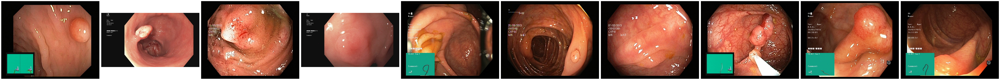

In [7]:
print("")
print("TRAINING DATA FOR polyps:")
print("")
images_details(polyps)
print("")
plot_images(polyps, 10)

In [8]:
train_datagen=ImageDataGenerator(rescale=1./255,shear_range=0.2,zoom_range=0.2,horizontal_flip=True)
training_set=train_datagen.flow_from_directory('DATASET/TRAIN',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 2107 images belonging to 7 classes.


In [9]:
test_datagen=ImageDataGenerator(rescale=1./255)
test_set=test_datagen.flow_from_directory('DATASET/TEST',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 2107 images belonging to 7 classes.


In [10]:
Classifier=Sequential()
Classifier.add(Convolution2D(32,(3,3),input_shape=(224,224,3),activation='relu'))
Classifier.add(MaxPooling2D(pool_size=(2,2)))
Classifier.add(Flatten())
Classifier.add(Dense(38, activation='relu'))
Classifier.add(Dense(7, activation='softmax'))
Classifier.compile(optimizer='rmsprop',loss='categorical_crossentropy',metrics=['accuracy'])

In [11]:
model_path = "MANUAL.h5"

callbacks = [
    ModelCheckpoint(model_path, monitor='accuracy', verbose=1, save_best_only=True)
]

In [12]:
epochs = 10
batch_size = 512

In [13]:
#### Fitting the model
history = Classifier.fit(
           training_set, steps_per_epoch=training_set.samples // batch_size, 
           epochs=epochs, 
           validation_data=test_set,validation_steps=test_set.samples // batch_size,
           callbacks=callbacks)

Epoch 1/10


4/4 [==============================] - ETA: 0s - loss: 101.4378 - accuracy: 0.1484
Epoch 1: accuracy improved from -inf to 0.14844, saving model to MANUAL.h5
4/4 [==============================] - 7s 2s/step - loss: 101.4378 - accuracy: 0.1484 - val_loss: 37.9178 - val_accuracy: 0.1016
Epoch 2/10
4/4 [==============================] - ETA: 0s - loss: 25.6195 - accuracy: 0.1562
Epoch 2: accuracy improved from 0.14844 to 0.15625, saving model to MANUAL.h5
4/4 [==============================] - 6s 2s/step - loss: 25.6195 - accuracy: 0.1562 - val_loss: 18.9521 - val_accuracy: 0.1562
Epoch 3/10
4/4 [==============================] - ETA: 0s - loss: 12.0365 - accuracy: 0.1951
Epoch 3: accuracy improved from 0.15625 to 0.19512, saving model to MANUAL.h5
4/4 [==============================] - 6s 2s/step - loss: 12.0365 - accuracy: 0.1951 - val_loss: 4.4633 - val_accuracy: 0.2891
Epoch 4/10
4/4 [==============================] - ETA: 0s - loss: 5.1649 - accuracy: 0.2734
Epoch 4: ac

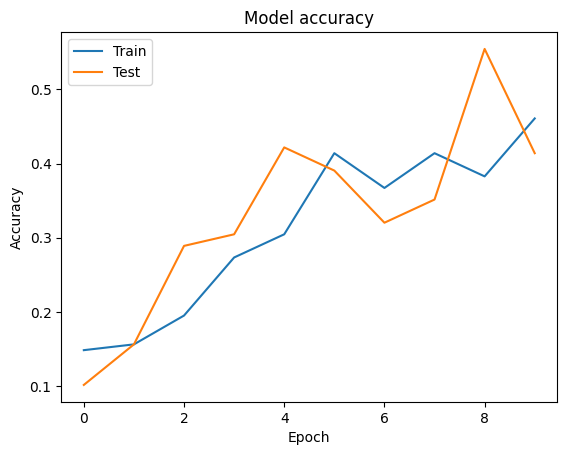

In [14]:
import matplotlib.pyplot as plt

def graph():
    #Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

graph()

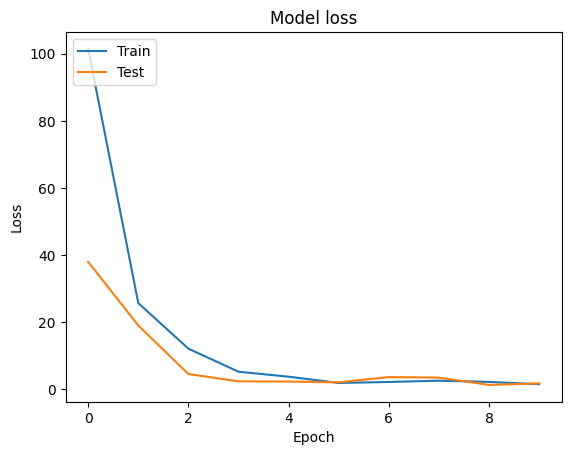

In [15]:
import matplotlib.pyplot as plt

def graph():
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
graph()